In [1]:
import sys
import os
# Add the directory containing 'thesis_utils.py' to the system path
sys.path.append(os.path.abspath('..'))  # If 'thesis_utils.py' is one level up
# Or use this if it's in the same directory as the notebook:
# sys.path.append(os.getcwd())
# os.environ["JULIA_NUM_THREADS"] = "8" 
os.environ["PYTHON_JULIACALL_HANDLE_SIGNALS"] = "yes"
os.environ["PYTHON_JULIACALL_THREADS"] = "auto"
os.environ["PYTHON_JULIACALL_OPTLEVEL"] = "3"
from pysr import PySRRegressor
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
from sdmetrics.single_column import KSComplement

from thesis_utils import *

Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


In [57]:
import importlib
import thesis_utils  # or whatever your module is called

importlib.reload(thesis_utils)

from thesis_utils import *

In [2]:
data = pd.read_csv("../../data/credit_score/credit_score_cleaned.csv")
# sub sampling due to degrading performance with too large datasets in denoising and SR
data_sample = data.sample(n=9600, random_state=42)

In [3]:
# Generate the profiling report
profile_full = ProfileReport(data, title="Credit Score", explorative=True)

# Display the report in the notebook
profile_full.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 27/27 [00:00<00:00, 100.12it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
# variable assignment according to correlation structure
independents_lst = ['Credit_History_Age', 'Delay_from_due_date', 'Num_Bank_Accounts', 'Num_Credit_Inquiries', 'Num_of_Delayed_Payment', 'Outstanding_Debt']
dependent_var = 'Interest_Rate'
X = data_sample[independents_lst].to_numpy()
y = data_sample[dependent_var].to_numpy()
data_sample = data_sample.reset_index()

12**2 * RBF(length_scale=30) + WhiteKernel(noise_level=20)


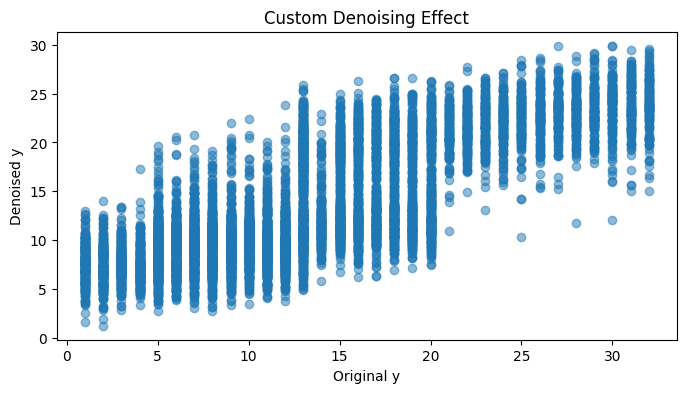

In [5]:
%matplotlib inline
y_denoised = bound_denoise(X, y, length_scale_bounds=(1e-3, 30), noise_level_bounds=(1e-5, 20), show_denoising_effect=True)

In [4]:
y_denoised = pd.read_csv('../../data/credit_score/credit_score_cleaned_denoised_sample.csv')['Interest_Rate']

In [7]:
data_denoised = data.copy()
data_denoised.loc[data_sample.index, 'Interest_Rate'] = y_denoised
data_denoised.to_csv('data/credit_score_cleaned_denoised_sample.csv', index=False)

In [8]:
sr_model = PySRRegressor(
        niterations=1024,  # Number of iterations to search for equations
        binary_operators=["+", "-", "*", "/"],
        unary_operators=["log", "abs", "sqrt"],
        maxdepth=10,
        elementwise_loss="loss(x, y) = (x - y)^2",  # Define loss function (mean squared error)
        verbosity=0,
        maxsize=50
    )
sr_model.fit(X, y_denoised)

PySRRegressor.equations_ = [
	    pick         score                                           equation  \
	0         0.000000e+00                                                 x4   
	1         2.929369e-01                                            x3 + x2   
	2         4.404601e-02                             x2 + (x3 - -1.0871874)   
	3         5.142845e-02                       x2 + (sqrt(x5) * 0.23888868)   
	4         9.587459e-02                           sqrt(sqrt(x3 * x5)) + x2   
	5         1.080278e-01                sqrt((x4 * x3) + (x5 * 0.07386297))   
	6         5.119893e-02        sqrt((x3 * x4) + ((x5 * 0.060445383) + x1))   
	7         4.094637e-02    sqrt((x3 * x4) + ((x2 * sqrt(x5)) * 0.5425434))   
	8         5.976362e-02  sqrt(((x3 * x4) + ((x2 * 0.010017627) * x5)) +...   
	9         4.476523e-02  sqrt((abs(x1) + (x3 * x4)) + ((x2 * 0.00975193...   
	10        4.760434e-02  sqrt((x4 * x2) + ((abs(x1) + (x5 * 0.019507898...   
	11        2.648187e-03  sqrt(((x3 * x4) + ((x2 * 0.007908912) * x5)) +...   
	12        3.018607e-02  sqrt(((x3 * x4) + (x1 * sqrt(x2))) + abs((x5 *...   
	13        5.868501e-04  sqrt(((sqrt(x2) * abs(x1)) + abs((x5 * 0.05296...   
	14        1.240780e-02  sqrt((((x2 + x1) * sqrt(x2)) + (x3 * x4)) + ab...   
	15        2.026120e-02  sqrt(abs(((x1 - x0) + (x5 * 0.022442995)) * 2....   
	16        8.825063e-03  sqrt(((abs(abs(x0 - (x5 * 0.06072104)) - x0) +...   
	17        3.176149e-02  sqrt((abs((x5 * 0.06144547) + ((x1 - x0) * 2.5...   
	18        1.073372e-03  sqrt(((x2 * x2) + (x4 * (x3 * 0.7699925))) + a...   
	19        2.921260e-02  sqrt((abs((x0 * 2.236278) - (x1 + (x5 * 0.0660...   
	20        1.443053e-02  sqrt(((x4 * (x3 / 1.2697201)) + x1) + (abs(abs...   
	21        7.710485e-04  sqrt((abs(abs(x1 + ((x5 * 0.060305372) - x0)) ...   
	22        3.194006e-02  sqrt((x2 * x2) + ((x1 + ((x3 * x4) / 1.3731729...   
	23        2.371534e-04  sqrt((((x3 * x4) / 1.373551) + ((x2 * x2) + ab...   
	24        1.225651e-02  sqrt((((x5 / 6.8553886) * x3) / (x0 + abs(x2 +...   
	25  >>>>  6.033854e-02  sqrt(((x3 * (x5 / 5.2031536)) / (x0 + abs((2.8...   
	26        1.166128e-02  sqrt((x5 * ((x3 / 5.0325446) / (abs((sqrt(x3) ...   
	27        1.395880e-02  sqrt(((x5 / 4.933147) * (x3 / (x0 + abs((x5 / ...   
	28        2.868475e-07  sqrt(((x5 / 4.931395) * (x3 / (abs(x0) + abs((...   
	29        3.245024e-03  sqrt(((x3 * (x5 / 5.0325446)) / (x0 + abs(((x1...   
	30        7.734089e-07  sqrt(((x3 * (x5 / 5.0325446)) / (x0 + abs(((ab...   
	31        5.267148e-03  sqrt((((x5 / 5.087248) * x3) / (abs(((x1 * 0.1...   
	32        5.377507e-05  sqrt((((x5 / 5.087248) * x3) / (abs((x5 / -141...   
	33        1.003267e-03  sqrt((((x5 / 5.087248) * x3) / (abs((abs(x1 * ...   
	34        1.206963e-02  sqrt(sqrt(((x4 * (x2 * (x1 + x3))) - -150.5246...   
	35        1.129191e-03  sqrt(sqrt((((x4 * (abs(x1) + x3)) * x2) - -150...   
	36        3.950225e-04  sqrt(sqrt(((x4 * ((abs(x1) + x3) * x2)) - -150...   
	37        2.038524e-04  sqrt(sqrt(((x4 * ((abs(x1) + x3) * x2)) - -150...   
	38        1.347116e-02  sqrt(sqrt(((x4 * (x4 + (x2 * x1))) - -175.5235...   
	39        5.661100e-03  sqrt(sqrt((((x4 * x2) * (x1 + abs(x4))) - -175...   
	40        5.655837e-03  sqrt(sqrt((((x4 * (x3 + x1)) * x2) - -150.5341...   
	41        1.268962e-03  sqrt(sqrt((((x4 * (x3 + abs(x1))) * x2) - -150...   
	42        5.579602e-03  sqrt(sqrt((((x4 + (x2 * (x1 + x3))) * x4) - -1...   
	43        1.325443e-04  sqrt(abs((x3 * ((x5 / 3.234994) + ((abs(x1) - ...   
	44        2.865085e-03  sqrt(sqrt((((x4 + (x2 * (x1 + x3))) * x4) - -1...   
	45        2.187269e-04  sqrt(sqrt((((x4 + (x2 * (x1 + x3))) * x4) - -1...   
	
	         loss  complexity  
	0   25.182234           1  
	1   14.016917           3  
	2   12.834963           5  
	3   12.191567           6  
	4   11.076989           7  
	5    9.942735           8  
	6    8.975012          10  
	7    8.614940          11  
	8    8.115163          12  
	9    7.75989

In [5]:
# 20250422_220910_EmTEJm
# candidate_function = generate_candidate_function("(((x4 * 0.42468578) + x2) + (12.247052 - ((x3 / (exp((((8.427565 - (x1 / 7.030286)) * x0) * 9.941596) / (x0 + (x5 / 3.7192376))) + x3)) * -27.02335))) * 0.427453")
# candidate_function = generate_candidate_function("0.5136726*x2 + 1.2973638799338*sqrt(x4) + 0.5136726*sqrt(Abs(x1)) + 0.5136726*Abs(x3 + log(x5)*sin(2.48172932259734*sin(log(x5) - 0.88440996)))")
candidate_function = generate_candidate_function("sqrt((x2 * x4) + (((x3 * (x1 + sqrt(x5))) / 3.2992833) + 54.727142)) + (x0 * -0.11721187)")
# candidate_function = generate_candidate_function("sqrt(sqrt((abs(((x5 * 0.023730611) + abs(x1)) - x0) + x4) * 5.247526) * (x2 + x3))")


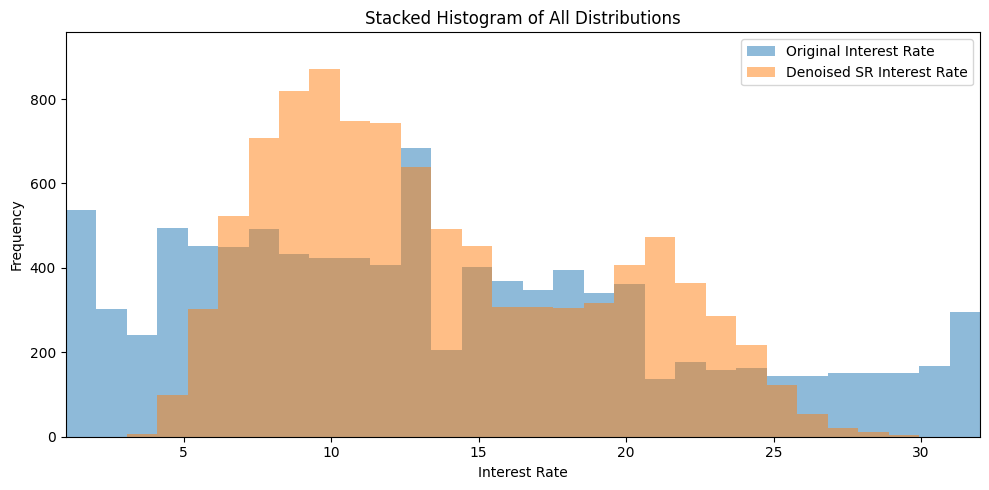

In [6]:
# X_aux = X[:, 1:6]
# y_denoised = candidate_function(X_aux)
y_denoised_sr = candidate_function(X)
plot_histograms([(y, 'Original Interest Rate', None), (y_denoised_sr, 'Denoised SR Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

In [27]:
kscomplement_score = KSComplement.compute(
    real_data=y,
    synthetic_data=y_denoised_sr
)
print(f'KSComplement Score = {round(kscomplement_score * 100, 2)}%')

KSComplement Score = 82.46%


<Figure size 640x480 with 0 Axes>

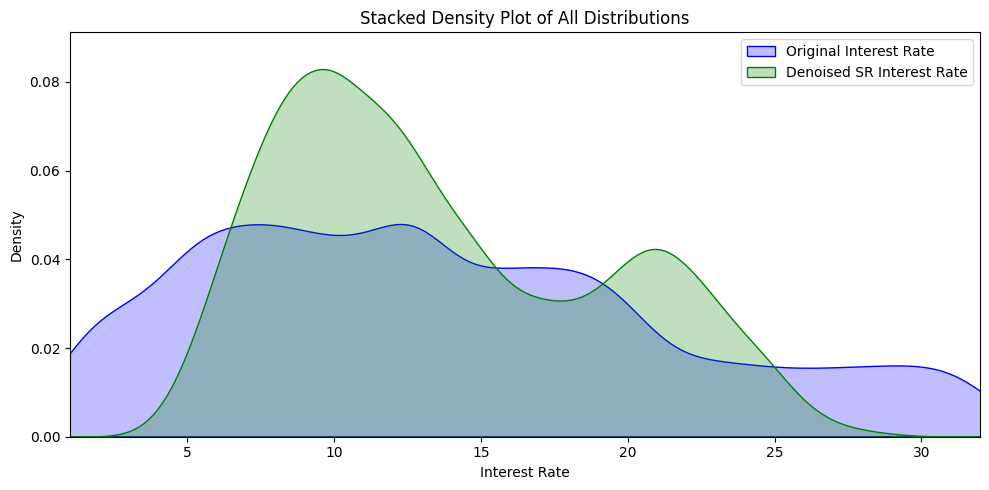

In [8]:
plot_densities([(y, 'Original Interest Rate', 'blue'), (y_denoised_sr, 'Denoised SR Interest Rate', 'green')], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

In [9]:
X_total = data[['Credit_History_Age', 'Delay_from_due_date', 'Num_Bank_Accounts', 'Num_Credit_Inquiries', 'Num_of_Delayed_Payment', 'Outstanding_Debt']].to_numpy()
y_total = data['Interest_Rate'].to_numpy()

In [10]:
y_denoised_sr_total = candidate_function(X_total)

In [11]:
orig_residuals = y_total - y_denoised_sr_total

In [22]:
y_total_corrected, best_amp, errors, _ = correct_predictions(y_total, y_denoised_sr_total, method='stratified', seed=42, clip_lower=0, clip_upper=32, original_residuals=None, tail_replace=True, lower_percentile=50, upper_percentile=50)
# ignore error in orig_residuals after first run

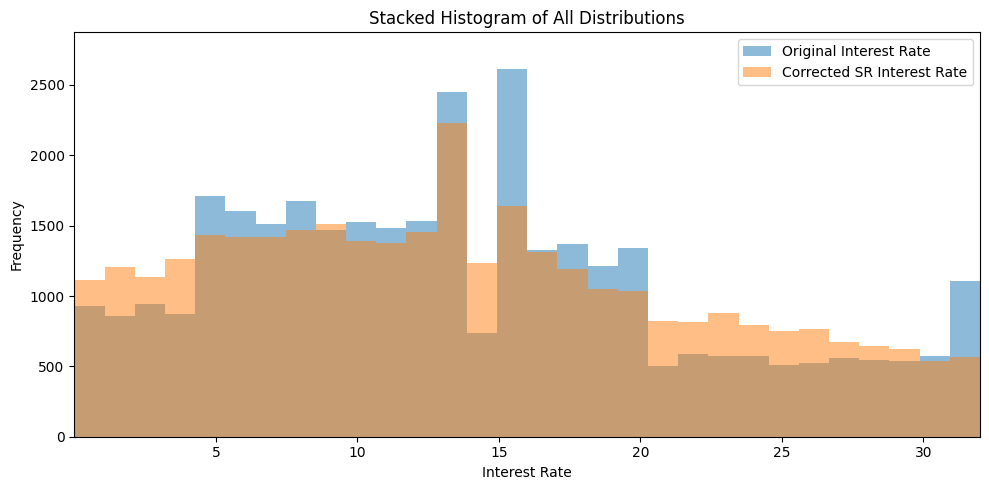

In [23]:
plot_histograms([(y_total, 'Original Interest Rate', None), (y_total_corrected, 'Corrected SR Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

In [28]:
kscomplement_score = KSComplement.compute(
    real_data=y_total,
    synthetic_data=y_total_corrected
)
print(f'KSComplement Score = {round(kscomplement_score * 100, 2)}%')

KSComplement Score = 94.59%


<Figure size 640x480 with 0 Axes>

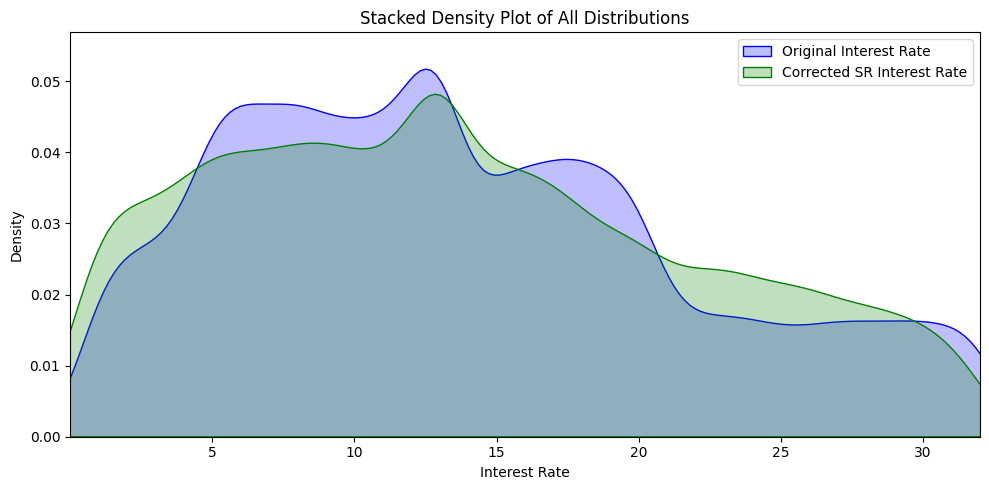

In [25]:
plot_densities([(y_total, 'Original Interest Rate', 'blue'), (y_total_corrected, 'Corrected SR Interest Rate', 'green')], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))

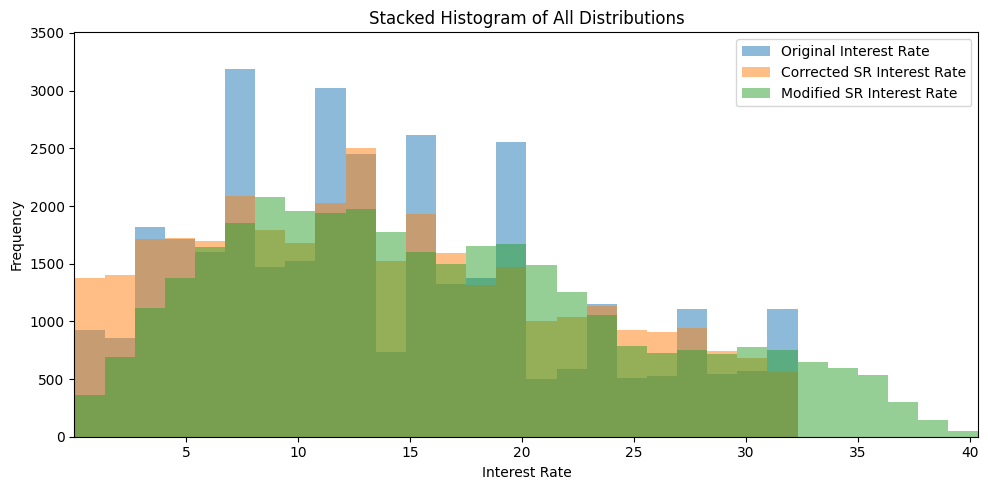

In [26]:
mod_candidate_function = generate_candidate_function("(((x4 * 0.42468578) + 2*x2) + (12.247052 - ((x3 / (exp((((8.427565 - (x1 / 7.030286)) * x0) * 9.941596) / (x0 + (x5 / 3.7192376))) + x3)) * -27.02335))) * 0.427453")
mod_y_sr_total = mod_candidate_function(X_total)
mod_y_total_corrected, best_amp, errors, _ = correct_predictions(y_total, mod_y_sr_total, method='stratified', amplification_factor=1.0, seed=42, clip_lower=0, clip_upper=None, original_residuals=orig_residuals, tail_replace=True, lower_percentile=50)
# ignore error in orig_residuals after first run
plot_histograms([(y_total, 'Original Interest Rate', None), (y_total_corrected, 'Corrected SR Interest Rate', None), (mod_y_total_corrected, 'Modified SR Interest Rate', None)], 'Interest Rate', stack=True, figsize_per_plot=(10, 5))